# eda008
snap_to_gridの実現性確認

In [1]:
import os
import pandas as pd
import ipynb_path
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
import seaborn as sns
import plotly
import plotly.express as px
%matplotlib inline
pd.set_option('display.max_rows', 200)

In [2]:
def get_nb_name():
    nb_path = ipynb_path.get()
    nb_name = nb_path.rsplit('/',1)[1].replace('.ipynb','')
    return nb_name

In [3]:
def visualize_trafic(df, center, zoom=9):
    fig = px.scatter_mapbox(df,
                            
                            # Here, plotly gets, (x,y) coordinates
                            lat="latDeg",
                            lon="lngDeg",
                            
                            #Here, plotly detects color of series
                            color="phoneName",
                            labels="phoneName",
                            
                            zoom=zoom,
                            center=center,
                            height=1000,
                            width=2000)
    fig.update_layout(mapbox_style='stamen-terrain')
    fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
    fig.update_layout(title_text="GPS trafic")
    fig.show()

In [4]:
def visualize_collection(df, collection):
    target_df = df[df['collectionName']==collection].copy()
    lat_center = target_df['latDeg'].mean()
    lng_center = target_df['lngDeg'].mean()
    center = {"lat":lat_center, "lon":lng_center}
    
    visualize_trafic(target_df, center)

In [5]:
# directory setting
nb_name = get_nb_name()
INPUT = '../input/google-smartphone-decimeter-challenge'
OUTPUT = '../output/' + nb_name
os.makedirs(OUTPUT, exist_ok=True)

In [6]:
# reading data
base_train = pd.read_csv(INPUT + '/' + 'baseline_locations_train.csv')
base_test = pd.read_csv(INPUT + '/' + 'baseline_locations_test.csv')
sample_sub = pd.read_csv(INPUT + '/' + 'sample_submission.csv')
ground_truth = pd.read_csv(INPUT + '/prep/ground_truth_train.csv')

In [7]:
base_train['phone'] = base_train['collectionName'] + '_' + base_train['phoneName']
ground_truth['phone'] = ground_truth['collectionName'] + '_' + ground_truth['phoneName']

In [8]:
base_train['area'] = base_train['collectionName'].str.split('-', expand=True)[4]
base_test['area'] = base_test['collectionName'].str.split('-', expand=True)[4]

In [9]:
base_train.drop_duplicates('collectionName')['area'].value_counts()

MTV    18
SVL     4
SJC     3
SF      2
RWC     2
Name: area, dtype: int64

In [10]:
base_test.drop_duplicates('collectionName')['area'].value_counts()

MTV    13
SJC     3
PAO     1
RWC     1
SVL     1
Name: area, dtype: int64

In [11]:
base_test.collectionName.unique()

array(['2020-05-15-US-MTV-1', '2020-05-28-US-MTV-1',
       '2020-05-28-US-MTV-2', '2020-06-04-US-MTV-2',
       '2020-06-10-US-MTV-1', '2020-06-10-US-MTV-2',
       '2020-08-03-US-MTV-2', '2020-08-13-US-MTV-1',
       '2021-03-16-US-MTV-2', '2021-03-16-US-RWC-2',
       '2021-03-25-US-PAO-1', '2021-04-02-US-SJC-1',
       '2021-04-08-US-MTV-1', '2021-04-21-US-MTV-1',
       '2021-04-22-US-SJC-2', '2021-04-26-US-SVL-2',
       '2021-04-28-US-MTV-2', '2021-04-29-US-MTV-2',
       '2021-04-29-US-SJC-3'], dtype=object)

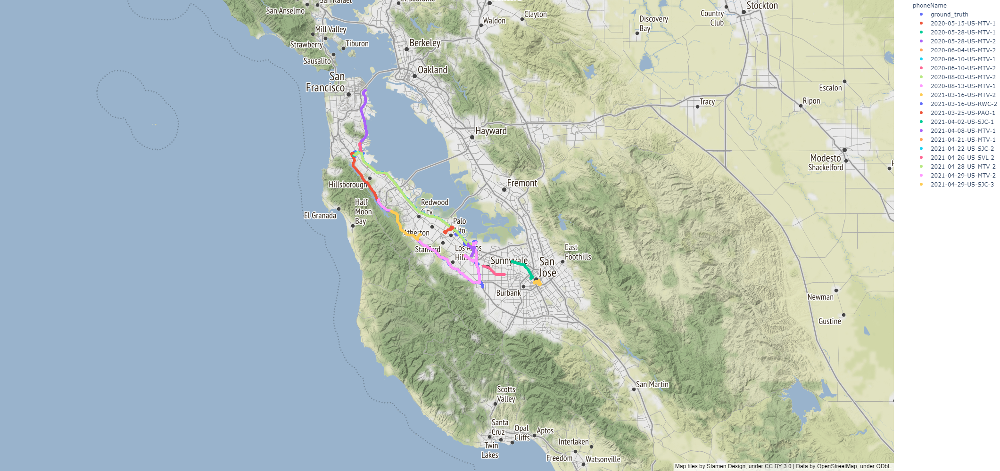

In [12]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = base_test.copy()
tmp2['phoneName'] = tmp2['collectionName']
tmp = pd.concat([tmp1, tmp2])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

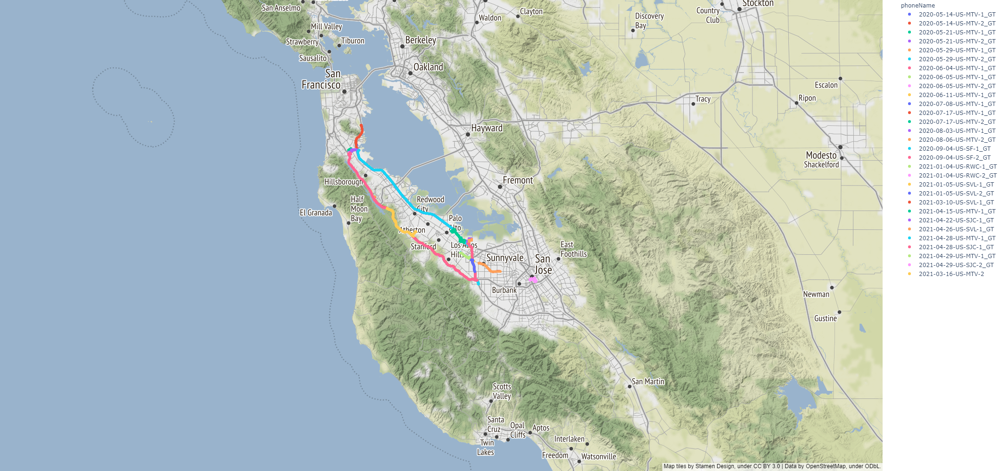

In [13]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = tmp1['collectionName'] + '_GT'
tmp2 = base_test[base_test['collectionName'].isin(['2021-03-16-US-MTV-2'])].copy()
tmp2['phoneName'] = tmp2['collectionName']
tmp = pd.concat([tmp1, tmp2])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')